# Implementing Reverse Image Search with Landmark Images

### Using a CNN to encode images into searchable semeantic vectors

## Description

---

In this project I explore using convolutional Neural Networks (CNNs) to encode an image into a latent space vector. This method can then be used to index those images to be searched against the vector of an input images to find visually similar images.

## Methods

---

I use images of landmarks in this project, and 3 different CNN archetectures to compare results

The 3 CNN archetectures that I use are:
- a made from scratch CNN with 4 convolutional layers and a classifier made of 3 fully connected layers, trained on the landmark image dataset
- an unmodified, pre-trained VGG16 network
- a VGG16 network with transfer learning, trained on the landmak image dataset

After training each model (if necessary) I use TSNE with 2 components to visualize the closeness of image vectors in 2D space of the 50 different landmark classes in the dataset. Classes are identified by the same colors and labled with thier class number, so clusters of classes indicate those image vectors are similar and it be feisable to use euclidian distance to determine visual similarity 

I then use a function I wrote to rank each images latent space vector aganst the vector of an input image to display visually similar images.

## Results

---

Overall this method of using vector similarity to lookup visually similar images works quite well. Additionally each model archetecture used for encoding the images have somewhat different properties and possible use cases.


### From Scratch CNN

While the scratch CNN architecture found a few images with the correct class, all the images share colors and textures with the input image. Looking a the TSNE for images encoded by this model, I can observe some loose clustering of classes. In my opinion, the top results all share the same "mood" and could find use in finding images that stylistically go well together, rather than share the same subject as the input image. This is supported by the TSNE obsevation wich shows significant overlap and spread of clusters.

### Pre-trained VGG network

The pre-trained VGG does better than the from-scratch CNN archetecture at identifying images that share the same subject as the input image; and the ones that it does image share colors, textures and composition with the input image. Looking at the TSNE, there are some loose clusters that appear slightly more condensed that the from-scratch TSNE, supports the observation that it preforms better than from-scratch model at identifying images of similar classes. The pre-trained VGG has the advantage of working out of the box - it does not need any fine tuning or trnasfer learning to work decently, making this approach suitable for a general reverse image search application where a specific domain cannot be trained for ahead of time.

### VGG Network with Transfer Learning

The most prominent observation from the transfer learning model is hos closely clustered most classes are in the TSNE. As a result, the reverse image search returns images of all the same class as the input images. This method of encoding has a very high accuracy but the tradeoff is that the subject domain of the images would need to be known ahead of time, a dataset needs to exist for it, and it needs to be trained with it. Where the vanilla pre-trained model could have use for general reverse image search use cases, transfer learning models could be used for specific domain areas. For example looking up shoes, or plants, or (in this case) landmarks.

### Imports

In [57]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torchvision
from torchvision import transforms, datasets
from torch.utils.data.sampler import SubsetRandomSampler
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np
from collections import OrderedDict
import time
import math

%matplotlib inline
%config InlineBackend.figure_format = 'retina'

### Loading the data

I use s a custom image loader that lets me refernce the path of the image later. This will allow me to assiociate image paths with thier encoded vector represntations when I rank images by vector similarity

In [58]:
class ImageFolderWithPaths(datasets.ImageFolder):
    """Custom dataset that includes image file paths. Extends
    torchvision.datasets.ImageFolder
    """

    # override the __getitem__ method. this is the method that dataloader calls
    def __getitem__(self, index):
        # this is what ImageFolder normally returns 
        original_tuple = super(ImageFolderWithPaths, self).__getitem__(index)
        # the image file path
        path = self.imgs[index][0]
        # make a new tuple that includes original and the path
        tuple_with_path = (original_tuple + (path,))
        return tuple_with_path

In [59]:
train_dir = 'landmark_images/train'
test_dir = 'landmark_images/test'

batch_size = 50
valid_size = 0.2

mean = np.array([0.485, 0.456, 0.406])
std = np.array([0.229, 0.224, 0.225])
normalization = transforms.Normalize(mean=mean, std=std)

data_transforms = {
  'augment': transforms.Compose([transforms.RandomRotation(30),
                              transforms.RandomResizedCrop(224),
                              transforms.RandomHorizontalFlip(),
                              transforms.ToTensor(),
                              normalization,]),
  'no_augment' : transforms.Compose([transforms.Resize(224),
                              transforms.CenterCrop(224),
                              transforms.ToTensor(),
                              normalization,])
}

image_datasets = {
  'train': ImageFolderWithPaths(train_dir, transform=data_transforms['augment']),
  'valid': ImageFolderWithPaths(train_dir, transform=data_transforms['no_augment']),
  'test' : ImageFolderWithPaths(test_dir, transform=data_transforms['no_augment'])
}

num_train = len(image_datasets['train'])
indices = list(range(num_train))
np.random.shuffle(indices)
split = int(np.floor(valid_size * num_train))
train_idx, valid_idx = indices[split:], indices[:split]

train_sampler = SubsetRandomSampler(train_idx)
valid_sampler = SubsetRandomSampler(valid_idx)

label_mapping = image_datasets['train'].classes
label_mapping = list(map(lambda x: x.split('.')[1].replace('_', ' '), label_mapping))
print(len(label_mapping), 'classes in this dataset')
print(label_mapping)

50 classes in this dataset
['Haleakala National Park', 'Mount Rainier National Park', 'Ljubljana Castle', 'Dead Sea', 'Wroclaws Dwarves', 'London Olympic Stadium', 'Niagara Falls', 'Stonehenge', 'Grand Canyon', 'Golden Gate Bridge', 'Edinburgh Castle', 'Mount Rushmore National Memorial', 'Kantanagar Temple', 'Yellowstone National Park', 'Terminal Tower', 'Central Park', 'Eiffel Tower', 'Changdeokgung', 'Delicate Arch', 'Vienna City Hall', 'Matterhorn', 'Taj Mahal', 'Moscow Raceway', 'Externsteine', 'Soreq Cave', 'Banff National Park', 'Pont du Gard', 'Seattle Japanese Garden', 'Sydney Harbour Bridge', 'Petronas Towers', 'Brooklyn Bridge', 'Washington Monument', 'Hanging Temple', 'Sydney Opera House', 'Great Barrier Reef', 'Monumento a la Revolucion', 'Badlands National Park', 'Atomium', 'Forth Bridge', 'Gateway of India', 'Stockholm City Hall', 'Machu Picchu', 'Death Valley National Park', 'Gullfoss Falls', 'Trevi Fountain', 'Temple of Heaven', 'Great Wall of China', 'Prague Astronomic

In [60]:
loaders = {
    'train': torch.utils.data.DataLoader(image_datasets['train'], batch_size=batch_size, sampler=train_sampler),
    'valid': torch.utils.data.DataLoader(image_datasets['valid'], batch_size=batch_size, sampler=valid_sampler),
    'test' : torch.utils.data.DataLoader(image_datasets['test'], batch_size=batch_size, shuffle=True),
}

### Inspect the data

Class: Matterhorn, Shape: torch.Size([3, 224, 224]), Path: landmark_images/test/20.Matterhorn/4604bdd17331afd1.jpg
Class: Changdeokgung, Shape: torch.Size([3, 224, 224]), Path: landmark_images/test/17.Changdeokgung/69f183db2f4660a3.jpg
Class: Sydney Opera House, Shape: torch.Size([3, 224, 224]), Path: landmark_images/test/33.Sydney_Opera_House/18e5c5ddf6e3a2a8.jpg
Class: Wroclaws Dwarves, Shape: torch.Size([3, 224, 224]), Path: landmark_images/test/04.Wroclaws_Dwarves/76ab32c9de8c6fc3.jpg
Class: Temple of Olympian Zeus, Shape: torch.Size([3, 224, 224]), Path: landmark_images/test/49.Temple_of_Olympian_Zeus/6c4eead9c295bf85.jpg


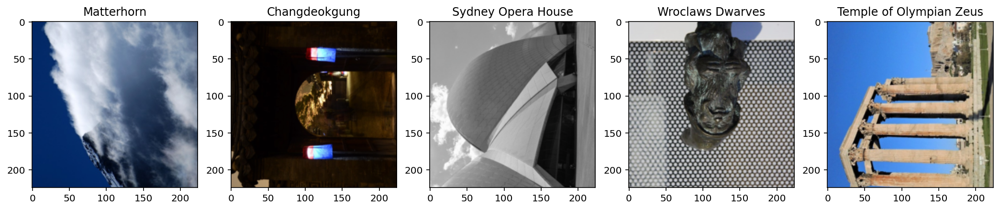

In [61]:
import matplotlib.pyplot as plt
%matplotlib inline

def show5(dataloader, label_mapping):
    dataiter = iter(dataloader)
    fig, ax = plt.subplots(figsize=(18, 10), ncols=5)

    batch = next(dataiter)
    labels = batch[1][0:5]
    images = batch[0][0:5]
    fname = batch[2][0:5]
    for i in range(5):
        title = label_mapping[labels[i].item()]
        print(f'Class: {title}, Shape: {images[i].shape}, Path: {fname[i]}')
        image = images[i].numpy().T
        image = std * image + mean
        image = np.clip(image, 0, 1)
        ax[i].set_title(title)
        ax[i].imshow(image)

show5(loaders['test'], label_mapping)


### Init device variable

In [62]:
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
print('using device', device)

using device cuda:0


### Helper functions 

In [63]:
def train(n_epochs, loaders, model, optimizer, criterion, save_path):
    valid_loss_min = np.Inf 
    for epoch in range(1, n_epochs+1):
        train_loss = []
        valid_loss = []
        
        model.train()
        for batch_idx, (data, targets, path) in enumerate(loaders['train']):
            data, targets = data.to(device), targets.to(device)
            optimizer.zero_grad()
            log_ps = model.forward(data)
            loss = criterion(log_ps, targets)
            loss.backward()
            optimizer.step()
            train_loss.append(loss.item())

        model.eval()
        for batch_idx, (data, targets, paths) in enumerate(loaders['valid']):
            data, targets = data.to(device), targets.to(device)
            with torch.no_grad():
                logits = model.forward(data)
                loss = criterion(logits, targets)
                valid_loss.append(loss.item())          

        train_loss = np.mean(train_loss)
        valid_loss = np.mean(valid_loss)

        print('Epoch: {} \tTraining Loss: {:.6f} \tValidation Loss: {:.6f}'.format(
            epoch, 
            train_loss,
            valid_loss
            ))

        if valid_loss < valid_loss_min:
            print('Validation loss has decreased, Saving...')
            valid_loss_min = valid_loss
            torch.save(model.state_dict(), save_path)
        
    return model

In [64]:
def test(loaders, model, criterion):
    ''' monitor test loss and accuracy '''

    test_loss = []
    correct = 0.
    total = 0.

    model.eval()
    for data, targets, paths in loaders['test']:
        data, targets = data.to(device), targets.to(device)
        with torch.no_grad():
            logits = model.forward(data)
            ps = nn.Softmax(dim=1)(logits)
            loss = criterion(logits, targets)
            test_loss.append(loss.item())
            _, top_class = ps.topk(1, dim=1)
            correct += torch.sum((top_class == targets.reshape(*top_class.shape)).type(torch.FloatTensor)).item()
            total += data.size(0)

    
    test_loss = np.mean(test_loss)
    print('Test Loss: {:.6f}\n'.format(test_loss))

    print('\nTest Accuracy: %2d%% (%2d/%2d)' % (
        100. * correct / total, correct, total))

### Define loss function and optimizer

In [65]:
criterion_scratch = nn.CrossEntropyLoss()

def get_optimizer_scratch(model):
    return optim.Adam(model.parameters()) 

### Define CNN

In [66]:
import torch.nn as nn

class Net(nn.Module):
    def __init__(self):
        super(Net, self).__init__()
        # sees 224x224x3 tesnsor
        self.conv1 = nn.Conv2d(3, 16, 3, stride=1, padding=1)
        self.conv1_bn = nn.BatchNorm2d(16)
        # sees 112x112x16 tensor
        self.conv2 = nn.Conv2d(16, 32, 3, stride=1, padding=1)
        self.conv2_bn = nn.BatchNorm2d(32)
        # sees 56x56x32 tensor
        self.conv3 = nn.Conv2d(32, 64, 3, stride=1, padding=1)
        self.conv3_bn = nn.BatchNorm2d(64)
        # sees 28x28x64 tensor
        self.conv4 = nn.Conv2d(64, 64, 3, stride=1, padding=1)
        self.conv4_bn = nn.BatchNorm2d(64)
        # outputs 14x14x64 tensor
        # expects flattened tensor with 12544 features
        self.classifier = nn.Sequential(OrderedDict([
            ('fc1', nn.Linear(12544, 500)),
            ('fc1_bn', nn.BatchNorm1d(500)),
            ('relu1', nn.ReLU()),
            ('dropout1', nn.Dropout(p=0.2)),
            ('fc2', nn.Linear(500, 250)),
            ('relu2', nn.ReLU()),
            ('fc2_bn', nn.BatchNorm1d(250)),
            ('dropout2', nn.Dropout(p=0.2)),
            ('fc3', nn.Linear(250, 100)),
            ('fc3_bn', nn.BatchNorm1d(100)),
            ('relu3', nn.ReLU()),
            ('dropout3', nn.Dropout(p=0.2)),
            ('fc_final', nn.Linear(100, 50)),
            ('fc_final_bn', nn.BatchNorm1d(50)),
        ]))
    
    def forward(self, x):

        x = self.conv1(x)
        x = F.relu(self.conv1_bn(x))
        x = F.max_pool2d(x,2)
        x = self.conv2(x)
        x = F.relu(self.conv2_bn(x))
        x = F.max_pool2d(x,2)
        x = self.conv3(x)
        x = F.relu(self.conv3_bn(x))
        x = F.max_pool2d(x,2)
        x = self.conv4(x)
        x = F.relu(self.conv4_bn(x))
        x = F.max_pool2d(x,2)
        
        x = x.view(-1, 14 * 14 * 64)
        x = self.classifier(x)
        
        self.log_ps = x
        return x

model_scratch = Net()
model_scratch = model_scratch.to(device)

### Train CNN

In [67]:
num_epochs = 20

model_scratch = train(num_epochs, loaders, model_scratch, get_optimizer_scratch(model_scratch), 
                      criterion_scratch, 'model_scratch.pt')

Epoch: 1 	Training Loss: 3.966160 	Validation Loss: 3.609412
Validation loss has decreased, Saving...
Epoch: 2 	Training Loss: 3.639434 	Validation Loss: 3.429342
Validation loss has decreased, Saving...
Epoch: 3 	Training Loss: 3.491118 	Validation Loss: 3.296315
Validation loss has decreased, Saving...
Epoch: 4 	Training Loss: 3.444666 	Validation Loss: 3.205290
Validation loss has decreased, Saving...
Epoch: 5 	Training Loss: 3.344889 	Validation Loss: 3.134634
Validation loss has decreased, Saving...
Epoch: 6 	Training Loss: 3.285052 	Validation Loss: 3.096872
Validation loss has decreased, Saving...
Epoch: 7 	Training Loss: 3.232281 	Validation Loss: 3.033380
Validation loss has decreased, Saving...
Epoch: 8 	Training Loss: 3.194169 	Validation Loss: 3.007727
Validation loss has decreased, Saving...
Epoch: 9 	Training Loss: 3.130373 	Validation Loss: 3.045103
Epoch: 10 	Training Loss: 3.072045 	Validation Loss: 2.832809
Validation loss has decreased, Saving...
Epoch: 11 	Training 

In [68]:
# load the model that got the best validation accuracy
model_scratch.load_state_dict(torch.load('model_scratch.pt'))
test(loaders, model_scratch, criterion_scratch)

Test Loss: 2.516867


Test Accuracy: 35% (440/1250)


### TSNE on images passed through scratch model

In [23]:
#add hook to intercept layer activations right before final layer
model_scratch.activation = {}
def get_activation(name):
    def hook(model, input, output):
        model_scratch.activation[name] = output.detach()
    return hook

model_scratch.classifier.relu3.register_forward_hook(get_activation('relu3'))


In [24]:
# process all test images into vectors of extracted freatures from CNN
data_scratch = {
    'activations': [],
    'labels': [],
    'paths': [],
    'layer': 'relu3',
}

model_scratch.eval()
with torch.no_grad():
    for data, targets, paths in loaders['test']:
        data_scratch['paths'].extend(paths)
        data_scratch['labels'].extend(targets)
        model_scratch.forward(data.to(device))
        data_scratch['activations'].extend(model_scratch.activation['relu3'].cpu().numpy())

data_scratch['activations'] = np.array(data_scratch['activations'])
data_scratch['labels'] = np.array(data_scratch['labels'])

print('number of images:', len(data_scratch['activations']))
print('number of input dimensions:', len(data_scratch['activations'][0]))

number of images: 1250
number of input dimensions: 100


/home/dylan/.pyenv/versions/3.7.10/envs/kitchen_sink/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,
/home/dylan/.pyenv/versions/3.7.10/envs/kitchen_sink/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,


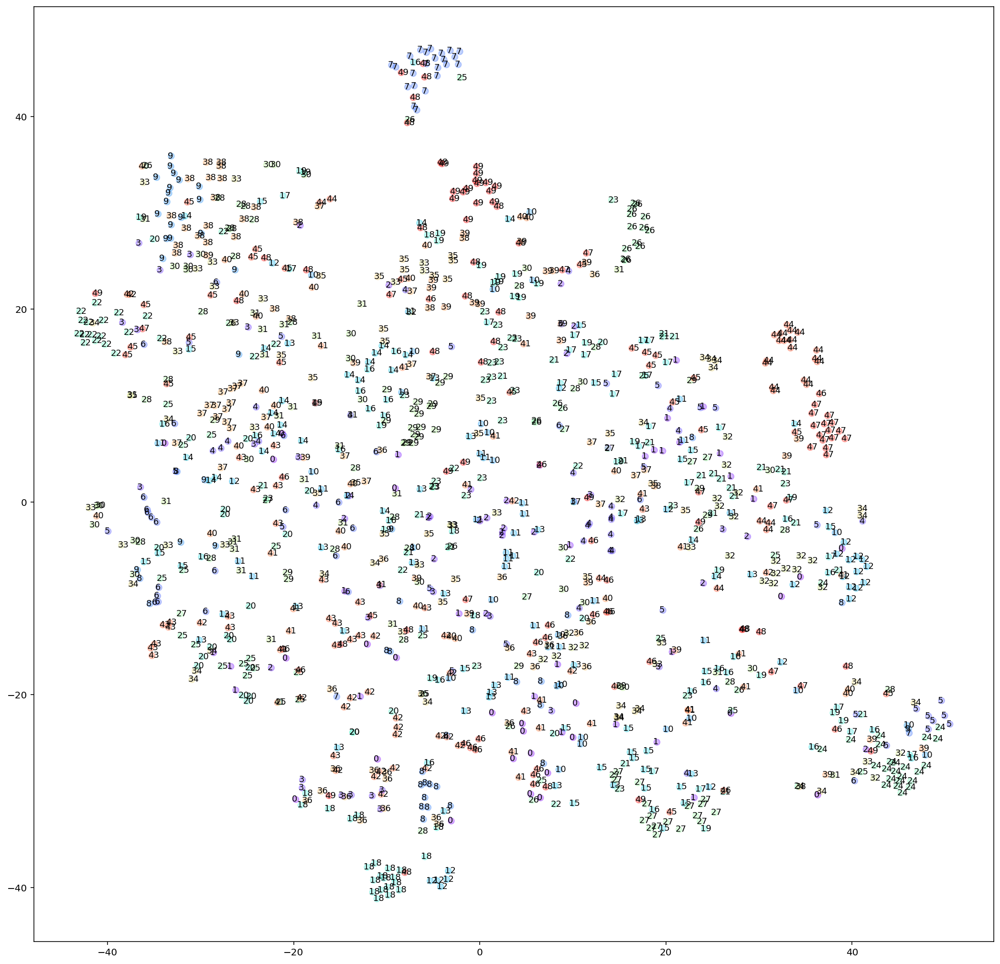

In [137]:
# run tsne with 2 components
from sklearn.manifold import TSNE

tsne = TSNE(n_components=2)
X_scratch, y_scratch = tsne.fit_transform(data_scratch['activations']).T

# examine clusters 
fig = plt.figure(figsize=(18, 18))
ax = fig.add_subplot()
scatter = ax.scatter(X_scratch, y_scratch, s=40, c=data_scratch['labels'], cmap='rainbow', alpha=0.3)

for x, y, l in zip(X_scratch, y_scratch, data_scratch['labels']):
  ax.text(x-0.4, y-0.2, l, fontsize=9)

plt.show()

### Reverse image search with scratch CNN

In [43]:
def euclidean_distance(pt1):
    return lambda pt2: np.linalg.norm(pt1 - pt2)

def reverse_image_search(img_path, model, data):
    img = Image.open(img_path)
    tensor_image = data_transforms['no_augment'](img).unsqueeze(0).to(device)

    plt.axis('off')
    plt.title('Input image:')
    plt.imshow(img)
    plt.show()

    model.eval()
    with torch.no_grad():
        model.forward(tensor_image)
        latent_space_vector = model.activation[data['layer']].cpu().numpy()

    distances = map(euclidean_distance(latent_space_vector), data['activations'])
    distances = [*zip(distances, data['paths'], data['labels'])]
    distances.sort(key=lambda x: x[0])
    fig, ax = plt.subplots(2, 5, figsize=(15, 5), constrained_layout=True)
    ax = [*ax[0], *ax[1]]
    for i in range(10):
        ax[i].set_title(label_mapping[distances[i][2]])
        ax[i].axis('off')
        ax[i].imshow(Image.open(distances[i][1]))
    fig.suptitle('Visually similar Images:', fontweight='bold')
    plt.show()


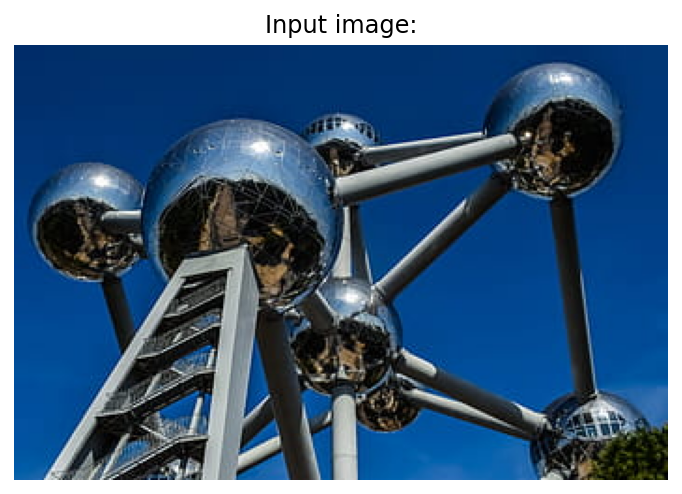

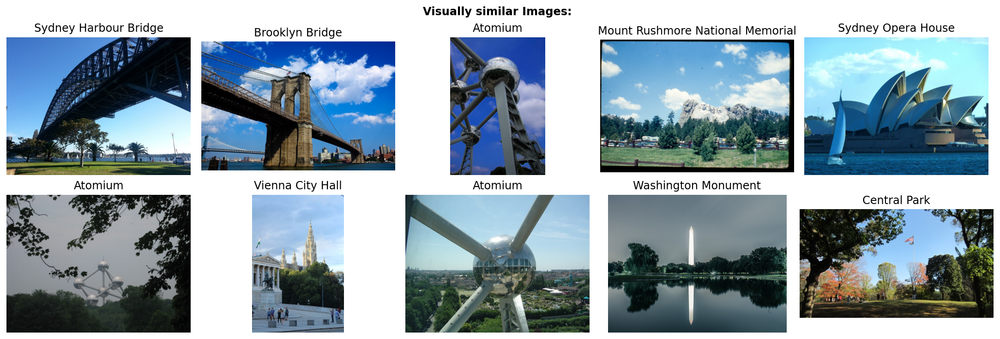

In [41]:
reverse_image_search('./assets/atomium.jpeg', model_scratch, data_scratch)

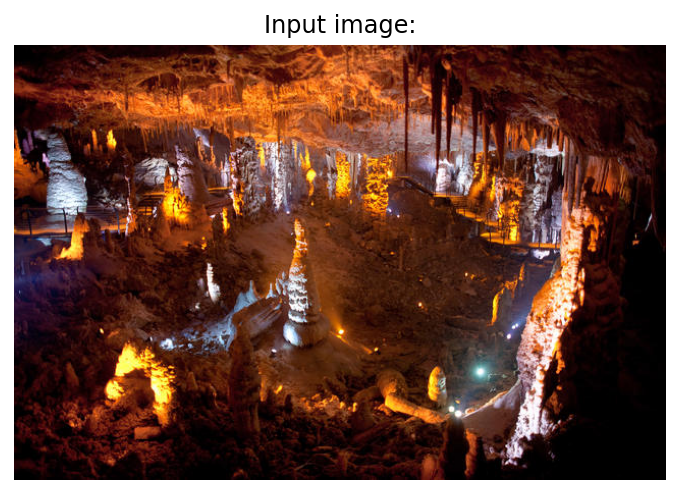

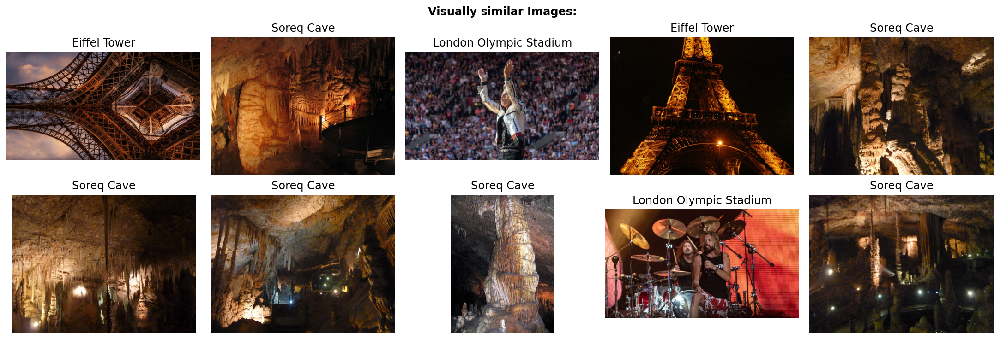

In [44]:
reverse_image_search('./assets/soreq_cave.jpeg', model_scratch, data_scratch)

### Pretrained VGG

In [10]:
vgg = torchvision.models.vgg16(pretrained=True)
for param in vgg.parameters():
    param.requires_grad = False

vgg = vgg.to(device)

vgg.classifier

Sequential(
  (0): Linear(in_features=25088, out_features=4096, bias=True)
  (1): ReLU(inplace=True)
  (2): Dropout(p=0.5, inplace=False)
  (3): Linear(in_features=4096, out_features=4096, bias=True)
  (4): ReLU(inplace=True)
  (5): Dropout(p=0.5, inplace=False)
  (6): Linear(in_features=4096, out_features=1000, bias=True)
)

### TSNE on images passed through pre-trained VGG 

In [11]:
#add hook to intercept layer activations right before final layer
vgg.activation = {}
def get_activation(name):
    def hook(model, input, output):
        vgg.activation[name] = output.detach()
    return hook

vgg.classifier[4].register_forward_hook(get_activation('penult_fc'))

In [12]:
# process all test images into vectors of extracted freatures from CNN
data_vgg = {
    'activations': [],
    'labels': [],
    'paths': [],
    'layer': 'penult_fc',
}

vgg.eval()
with torch.no_grad():
    for data, targets, paths in loaders['test']:
        data_vgg['paths'].extend(paths)
        data_vgg['labels'].extend(targets)
        vgg.forward(data.to(device))
        data_vgg['activations'].extend(vgg.activation['penult_fc'].cpu().numpy())

data_vgg['activations'] = np.array(data_vgg['activations'])
data_vgg['labels'] = np.array(data_vgg['labels'])

print('number of images:', len(data_vgg['activations']))
print('number of input dimensions:', len(data_vgg['activations'][0]))

number of images: 1250
number of input dimensions: 4096


/home/dylan/.pyenv/versions/3.7.10/envs/kitchen_sink/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,
/home/dylan/.pyenv/versions/3.7.10/envs/kitchen_sink/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,


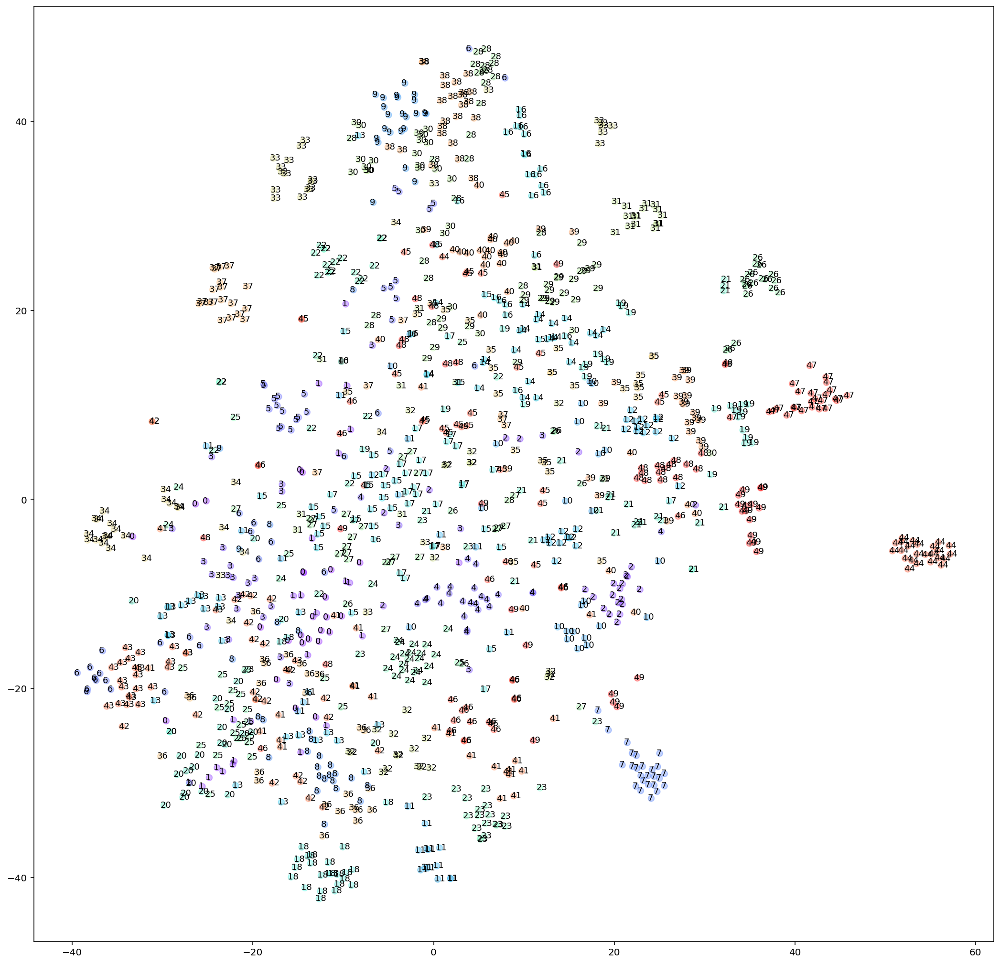

In [13]:
# run tsne with 2 components
from sklearn.manifold import TSNE

tsne = TSNE(n_components=2)
X_vgg, y_vgg = tsne.fit_transform(data_vgg['activations']).T

# examine clusters 
fig = plt.figure(figsize=(18, 18))
ax = fig.add_subplot()
scatter = ax.scatter(X_vgg, y_vgg, s=40, c=data_vgg['labels'], cmap='rainbow', alpha=0.3)

for x, y, l in zip(X_vgg, y_vgg, data_vgg['labels']):
  ax.text(x-0.4, y-0.2, l, fontsize=9)

plt.show()

### Reverse Image search with pre-trained vgg

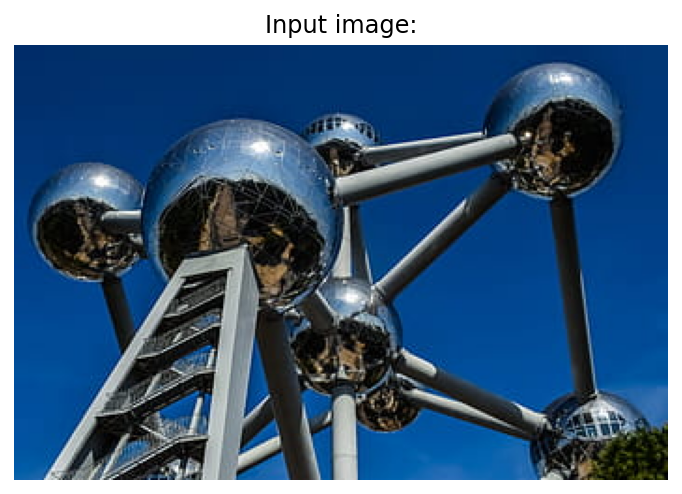

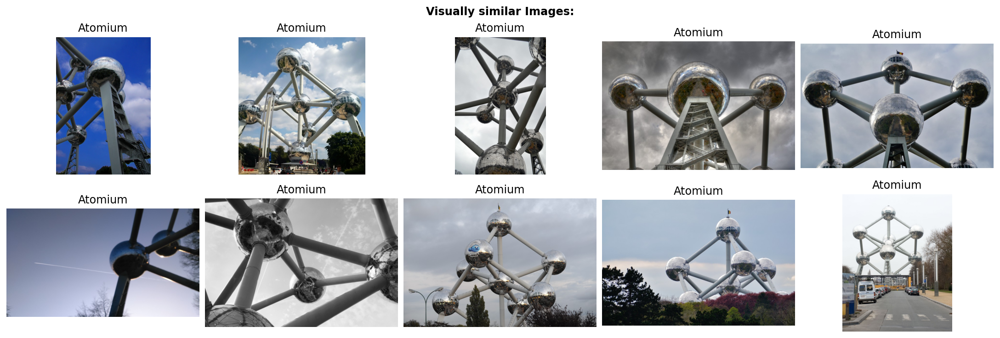

In [45]:
reverse_image_search('./assets/atomium.jpeg', vgg, data_vgg)

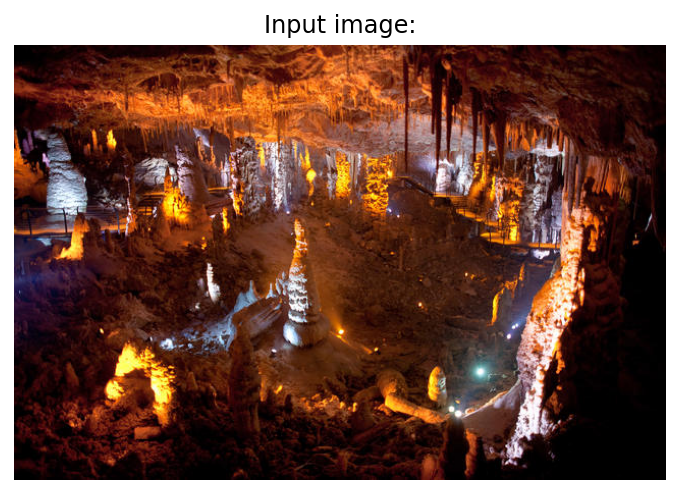

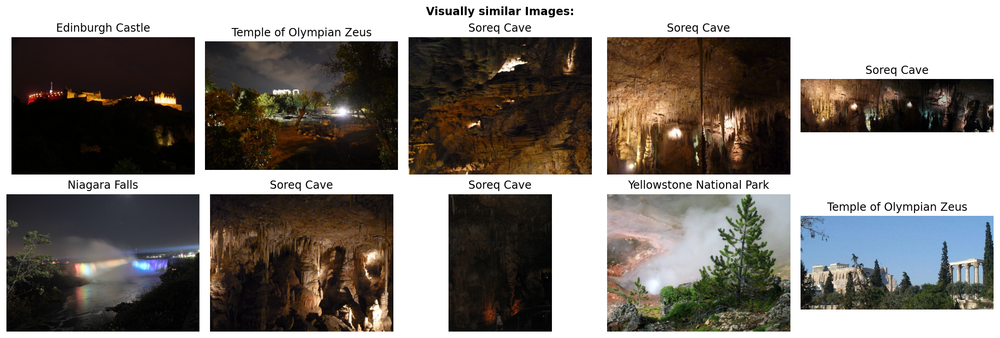

In [46]:
reverse_image_search('./assets/soreq_cave.jpeg', vgg, data_vgg)

### Transfer learning Model

In [48]:
criterion_transfer = nn.CrossEntropyLoss()

def get_optimizer_transfer(model):
    return optim.Adam(model.parameters())    

### Define transfer learning model

In [49]:
model_transfer = torchvision.models.vgg16(pretrained=True)
for param in model_transfer.parameters():
    param.requires_grad = False

print('model\'s classifier expects', model_transfer.classifier[0].in_features, 'in_features')

model_transfer.classifier = nn.Sequential(OrderedDict([
                ('fc1', nn.Linear(25088, 5000)),
                ('relu1', nn.ReLU()),
                ('dropout1', nn.Dropout(p=0.2)),
                ('fc2', nn.Linear(5000, 1000)),
                ('relu2', nn.ReLU()),
                ('dropout2', nn.Dropout(p=0.2)),
                ('fc3', nn.Linear(1000, 500)),
                ('relu3', nn.ReLU()),
                ('dropout3', nn.Dropout(p=0.2)),
                ('fc4', nn.Linear(500, 100)),
                ('relu4', nn.ReLU()),
                ('dropout4', nn.Dropout(p=0.2)),
                ('fc_final', nn.Linear(100, 50)),
            ]))

model_transfer = model_transfer.to(device)

model's classifier expects 25088 in_features


### Train transfer learning model

In [50]:
num_epochs = 20
model_transfer = train(num_epochs, loaders, model_transfer, get_optimizer_transfer(model_transfer), 
                      criterion_transfer, 'model_transfer.pt')


Epoch: 1 	Training Loss: 3.475131 	Validation Loss: 2.528063
Validation loss has decreased, Saving...
Epoch: 2 	Training Loss: 2.607294 	Validation Loss: 1.929322
Validation loss has decreased, Saving...
Epoch: 3 	Training Loss: 2.196266 	Validation Loss: 1.785241
Validation loss has decreased, Saving...
Epoch: 4 	Training Loss: 1.969297 	Validation Loss: 1.637137
Validation loss has decreased, Saving...
Epoch: 5 	Training Loss: 1.805489 	Validation Loss: 1.509824
Validation loss has decreased, Saving...
Epoch: 6 	Training Loss: 1.664370 	Validation Loss: 1.362865
Validation loss has decreased, Saving...
Epoch: 7 	Training Loss: 1.601558 	Validation Loss: 1.397256
Epoch: 8 	Training Loss: 1.543756 	Validation Loss: 1.295775
Validation loss has decreased, Saving...
Epoch: 9 	Training Loss: 1.472373 	Validation Loss: 1.449446
Epoch: 10 	Training Loss: 1.365829 	Validation Loss: 1.275147
Validation loss has decreased, Saving...
Epoch: 11 	Training Loss: 1.401274 	Validation Loss: 1.321903

In [51]:
model_transfer.load_state_dict(torch.load('model_transfer.pt'))
test(loaders, model_transfer, criterion_transfer)

Test Loss: 1.093948


Test Accuracy: 72% (911/1250)


### Reverse Image search with transfer learning model

In [52]:
#add hook to intercept layer activations right before final layer
model_transfer.activation = {}
def get_activation(name):
    def hook(model, input, output):
        model_transfer.activation[name] = output.detach()
    return hook

model_transfer.classifier.relu4.register_forward_hook(get_activation('relu4'))

In [53]:
# process all test images into vectors of extracted freatures from CNN
data_transfer = {
    'activations': [],
    'labels': [],
    'paths': [],
    'layer': 'relu4',
}

model_transfer.eval()
with torch.no_grad():
    for data, targets, paths in loaders['test']:
        data_transfer['paths'].extend(paths)
        data_transfer['labels'].extend(targets)
        model_transfer.forward(data.to(device))
        data_transfer['activations'].extend(model_transfer.activation['relu4'].cpu().numpy())

data_transfer['activations'] = np.array(data_transfer['activations'])
data_transfer['labels'] = np.array(data_transfer['labels'])

print('number of images:', len(data_transfer['activations']))
print('number of input dimensions:', len(data_transfer['activations'][0]))

number of images: 1250
number of input dimensions: 100


/home/dylan/.pyenv/versions/3.7.10/envs/kitchen_sink/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,
/home/dylan/.pyenv/versions/3.7.10/envs/kitchen_sink/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,


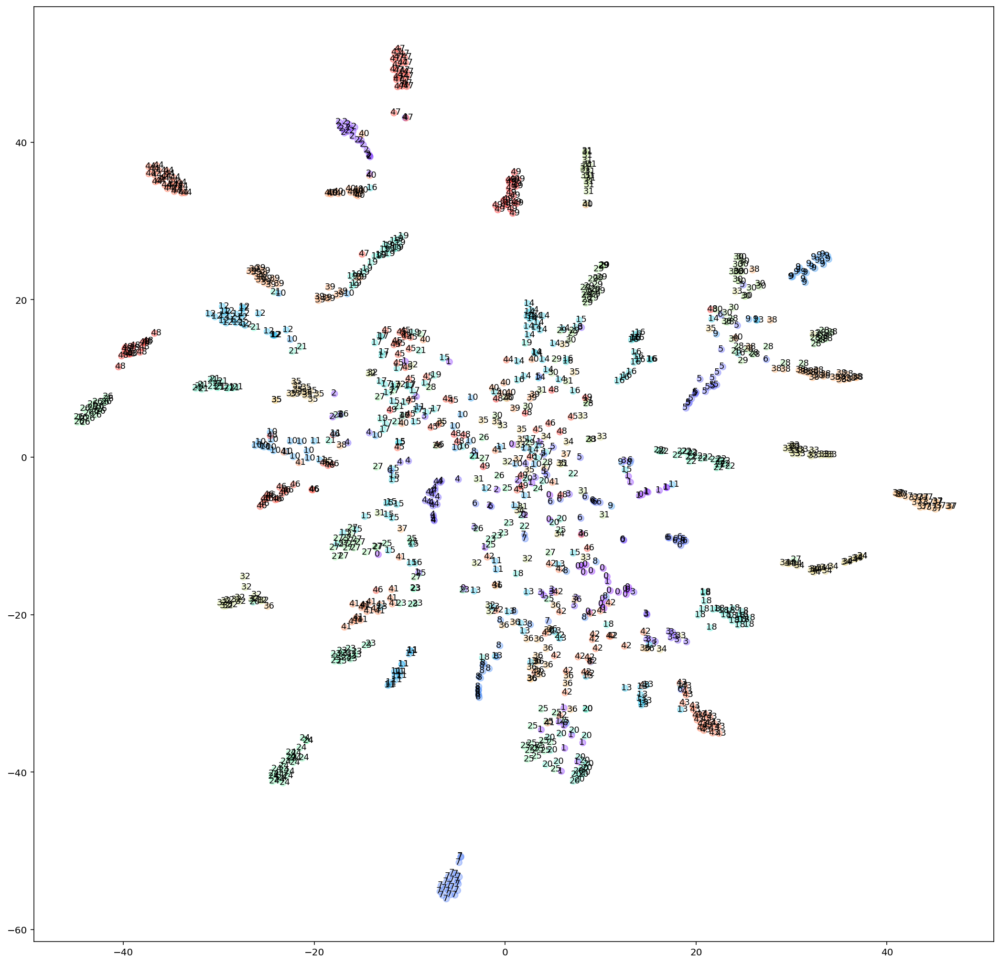

In [54]:
# run tsne with 2 components
from sklearn.manifold import TSNE

tsne = TSNE(n_components=2)
X_transfer, y_transfer = tsne.fit_transform(data_transfer['activations']).T

# examine clusters 
fig = plt.figure(figsize=(18, 18))
ax = fig.add_subplot()
scatter = ax.scatter(X_transfer, y_transfer, s=40, c=data_transfer['labels'], cmap='rainbow', alpha=0.3)

for x, y, l in zip(X_transfer, y_transfer, data_transfer['labels']):
  ax.text(x-0.4, y-0.2, l, fontsize=9)

plt.show()

### Reverse image search with transfer learning model

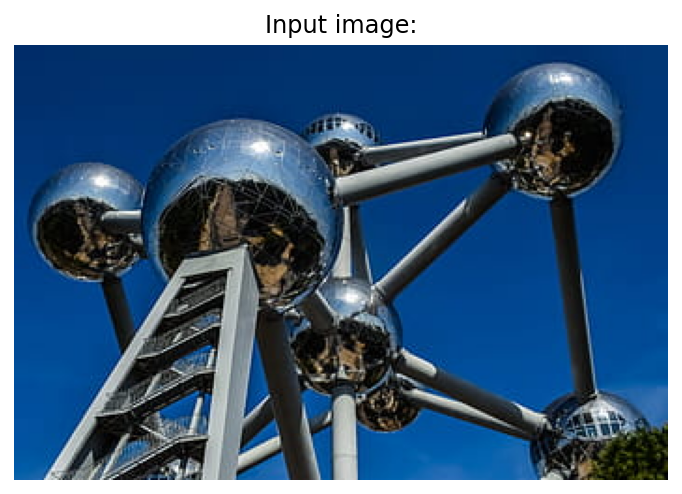

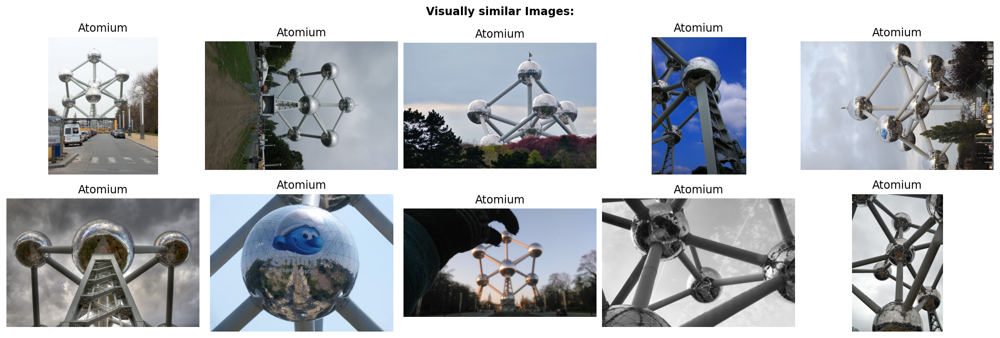

In [55]:
reverse_image_search('./assets/atomium.jpeg', model_transfer, data_transfer)

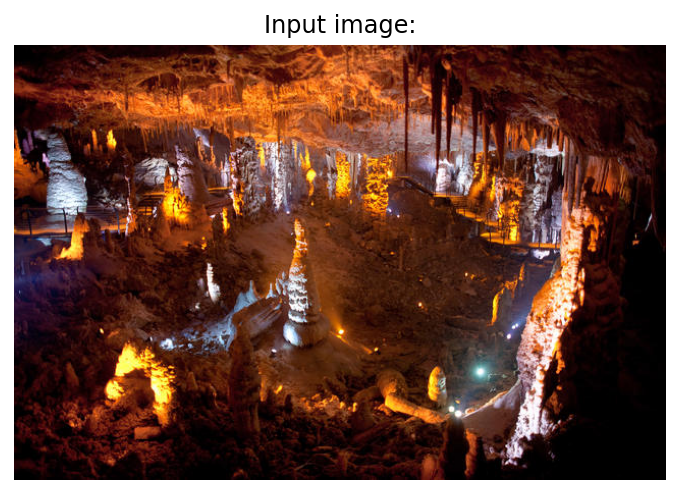

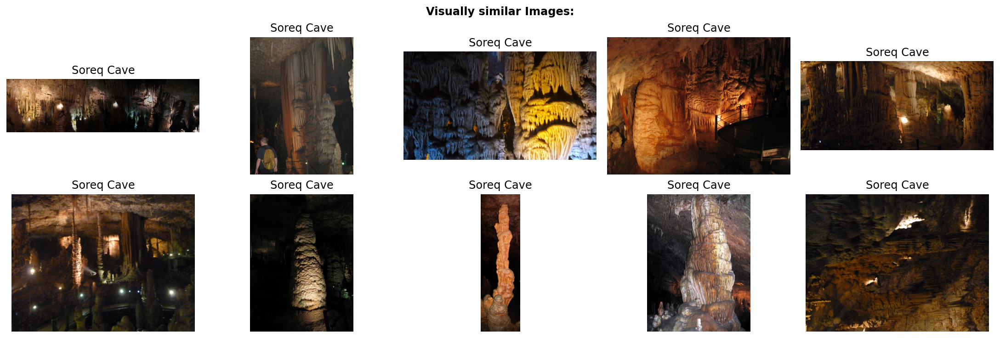

In [56]:
reverse_image_search('./assets/soreq_cave.jpeg', model_transfer, data_transfer)